<a href="https://colab.research.google.com/github/yxong1114/fall-detection/blob/main/two_step_fall_detection_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Person Detection Model

## Import Required Libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import cv2
import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
import warnings
warnings.filterwarnings('ignore')

from sklearn.metrics import confusion_matrix, classification_report

import tensorflow as tf

## Clone TensorFlow Model

In [2]:
# Clone Tensorflow model repo
%cd /content
!git clone --quiet https://github.com/tensorflow/models.git
# Compile protocol buffers
%cd /content/models/research
!protoc object_detection/protos/*.proto --python_out=.
!cp object_detection/packages/tf2/setup.py .
# Set environment variables
import os
os.environ['PYTHONPATH'] += ':/content/models:/content/models/research/:/content/models/research/slim/'
# Install libraries
!pip install .
# Test
!python object_detection/builders/model_builder_test.py

/content
/content/models/research
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.3/14.3 MB 74.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 75.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.0/28.0 MB 13.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 kB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.1/175.1 kB 21.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 91.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/4

## Download Pretrained Model

In [3]:
%cd /content/models/research

import os
import shutil
import glob
import urllib.request
import tarfile
model_name = 'ssd_mobilenet_v2_320x320_coco17_tpu-8'
MODEL_FILE = model_name + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/'
DEST_DIR = '/content/models/research/pretrained_model'

if not (os.path.exists(MODEL_FILE)):
    urllib.request.urlretrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
    shutil.rmtree(DEST_DIR)
os.rename(model_name, DEST_DIR)

# Check downloaded files
!echo {DEST_DIR}
!ls -alh {DEST_DIR}

# Set fine tune checkpoint
fine_tune_checkpoint = os.path.join(DEST_DIR, "checkpoint/ckpt-0")
print("fine_tune_checkpoint: ", fine_tune_checkpoint)

/content/models/research
/content/models/research/pretrained_model
total 24K
drwxr-x---  4 345018 89939 4.0K Jul 11  2020 .
drwxr-xr-x 25 root   root  4.0K May 21 07:49 ..
drwxr-x---  2 345018 89939 4.0K Jul 10  2020 checkpoint
-rw-r-----  1 345018 89939 4.4K Jul 11  2020 pipeline.config
drwxr-x---  3 345018 89939 4.0K Jul 10  2020 saved_model
fine_tune_checkpoint:  /content/models/research/pretrained_model/checkpoint/ckpt-0


## Clone Project Repo

In [4]:
%cd /content

# Repo URL
repo_url = 'https://github.com/yxong1114/fall-detection'

!git clone {repo_url}

/content
Cloning into 'fall-detection'...
remote: Enumerating objects: 2697, done.
remote: Counting objects: 100% (41/41), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 2697 (delta 12), reused 29 (delta 6), pack-reused 2656
Receiving objects: 100% (2697/2697), 2.62 GiB | 37.28 MiB/s, done.
Resolving deltas: 100% (832/832), done.
Updating files: 100% (2858/2858), done.


## Set Images for Inference

In [5]:
import os

# Use images in test dir (update this if you have other images for inference)
IMAGE_DIR = '/content/fall-detection/images_v2/test/'
IMAGE_PATHS = []

for file in os.listdir(IMAGE_DIR):
    if file.endswith(".jpg") or file.endswith(".png"):
        IMAGE_PATHS.append(os.path.join(IMAGE_DIR, file))

IMAGE_PATHS

['/content/fall-detection/images_v2/test/walk (23).png',
 '/content/fall-detection/images_v2/test/fall (24).png',
 '/content/fall-detection/images_v2/test/fall (7).png',
 '/content/fall-detection/images_v2/test/fall (28).png',
 '/content/fall-detection/images_v2/test/sit (32).png',
 '/content/fall-detection/images_v2/test/sit (44).png',
 '/content/fall-detection/images_v2/test/walk (31).png',
 '/content/fall-detection/images_v2/test/walk (44).png',
 '/content/fall-detection/images_v2/test/sit (12).png',
 '/content/fall-detection/images_v2/test/walk (48).png',
 '/content/fall-detection/images_v2/test/fall (4).png',
 '/content/fall-detection/images_v2/test/walk (36).png',
 '/content/fall-detection/images_v2/test/fall (47).png',
 '/content/fall-detection/images_v2/test/walk (43).png',
 '/content/fall-detection/images_v2/test/sit (24).png',
 '/content/fall-detection/images_v2/test/walk (35).png',
 '/content/fall-detection/images_v2/test/sit (28).png',
 '/content/fall-detection/images_v2/te

## Load Pretrained Model

In [6]:
%cd /content

import time
import tensorflow as tf # Added as colab instance often crash
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

# Label Map path
PATH_TO_LABELS = '/content/fall-detection/annotations/mscoco_label_map.pbtxt'
# Saved model path
PATH_TO_SAVED_MODEL = '/content/models/research/pretrained_model/saved_model'

print('Loading model...', end='')
start_time = time.time()

# Load saved model and build the detection function
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# Set category index
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)

/content
Loading model...Done! Took 29.4279146194458 seconds


## Make Prediction for Human Detection & Crop Image

Running inference for /content/fall-detection/images_v2/test/walk (23).png... 
Done
Running inference for /content/fall-detection/images_v2/test/fall (24).png... 
Done
Running inference for /content/fall-detection/images_v2/test/fall (7).png... 
Done
Running inference for /content/fall-detection/images_v2/test/fall (28).png... 
Done
Running inference for /content/fall-detection/images_v2/test/sit (32).png... 
Done
Running inference for /content/fall-detection/images_v2/test/sit (44).png... 
Done
Running inference for /content/fall-detection/images_v2/test/walk (31).png... 
Done
Running inference for /content/fall-detection/images_v2/test/walk (44).png... 
Done
Running inference for /content/fall-detection/images_v2/test/sit (12).png... 
Done
Running inference for /content/fall-detection/images_v2/test/walk (48).png... 
Done
Running inference for /content/fall-detection/images_v2/test/fall (4).png... 
Done
Running inference for /content/fall-detection/images_v2/test/walk (36).png... 
Do

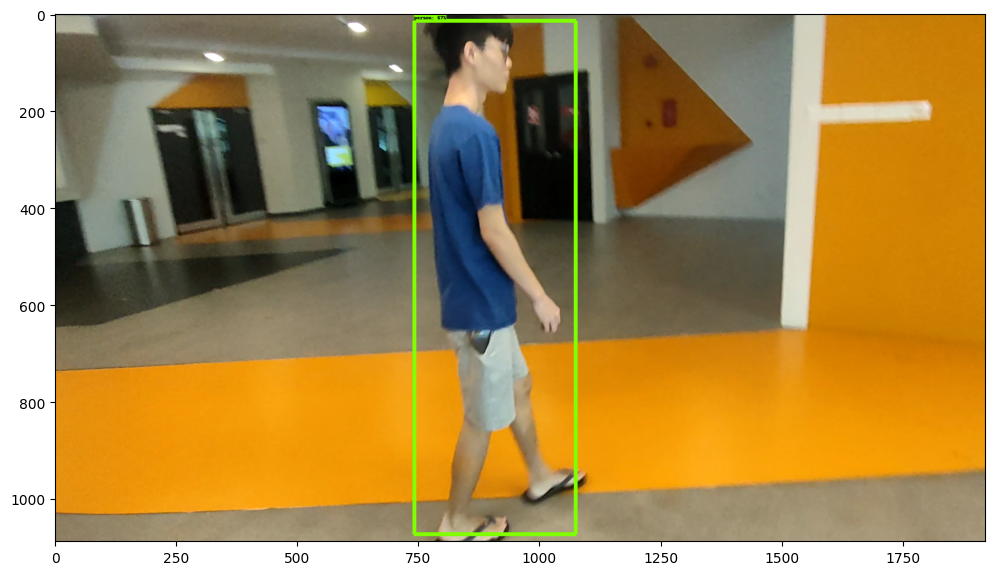

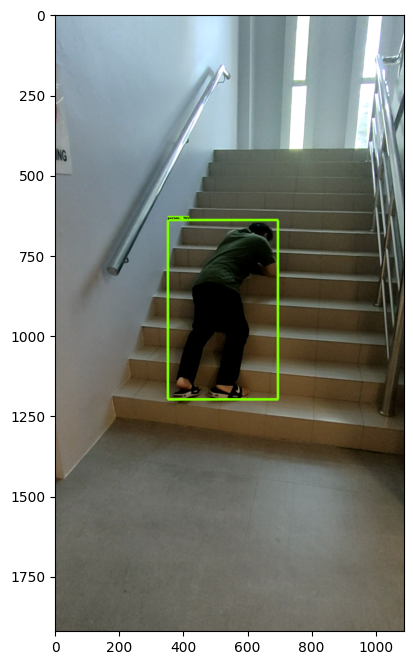

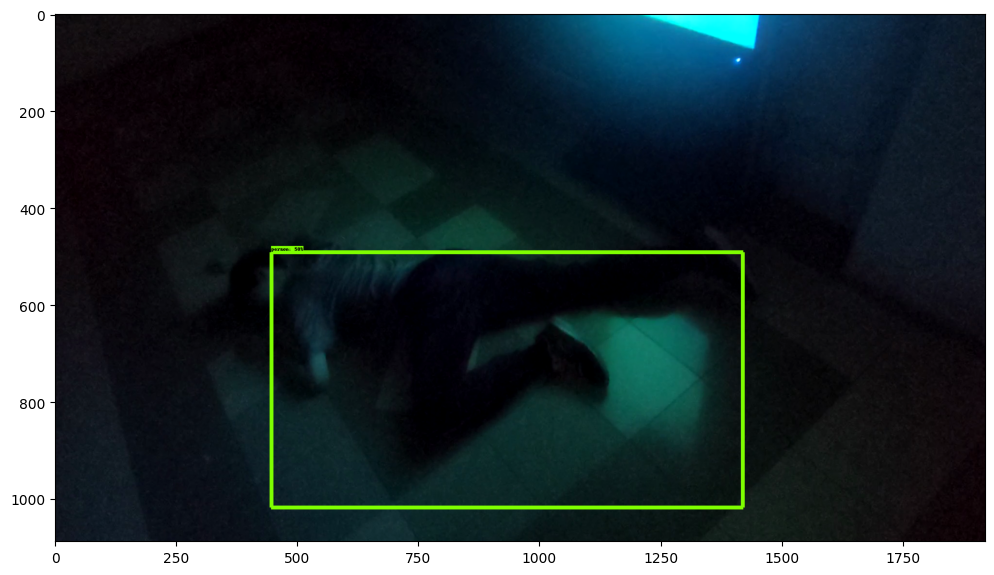

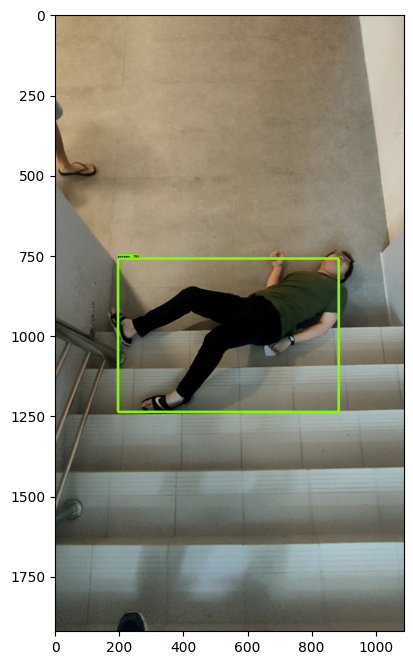

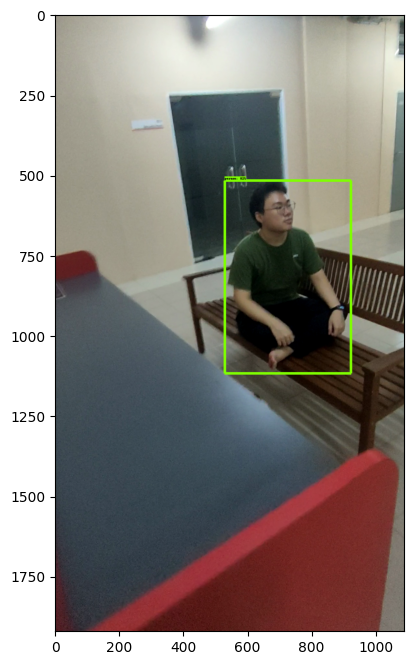

...

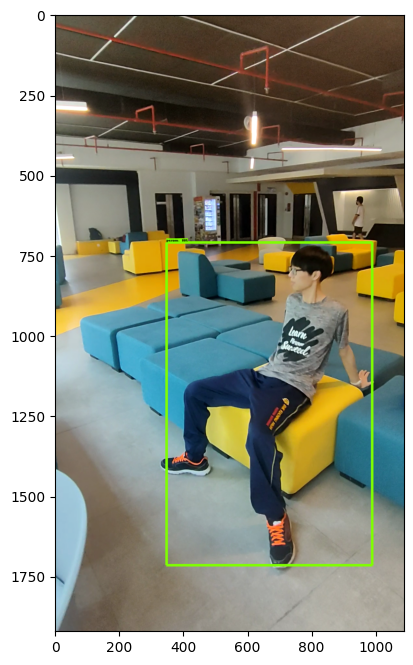

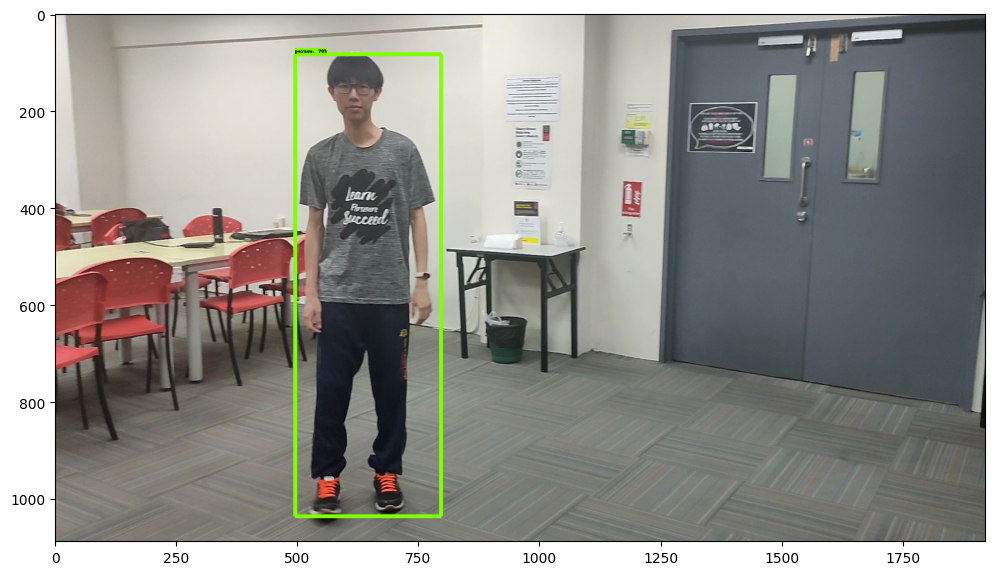

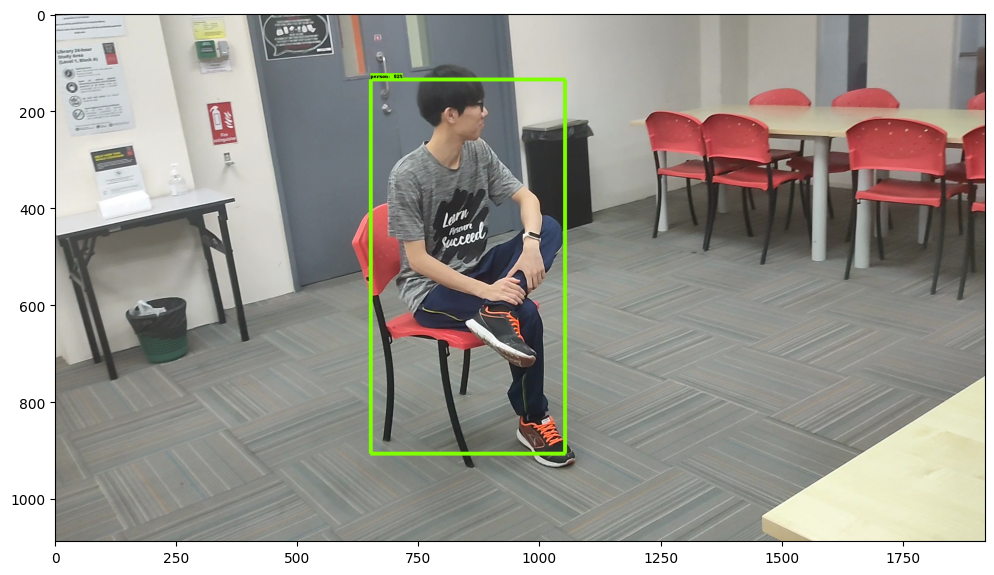

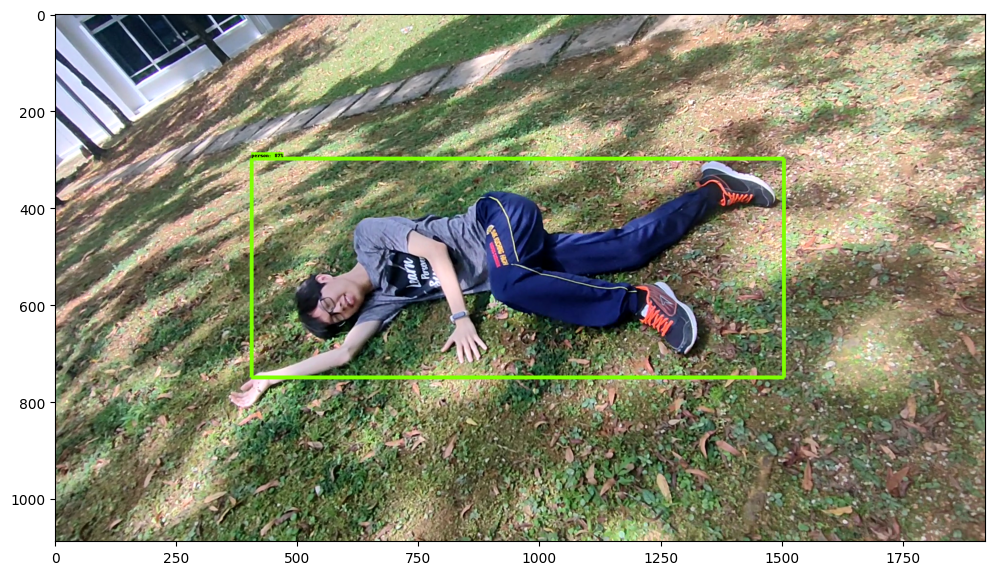

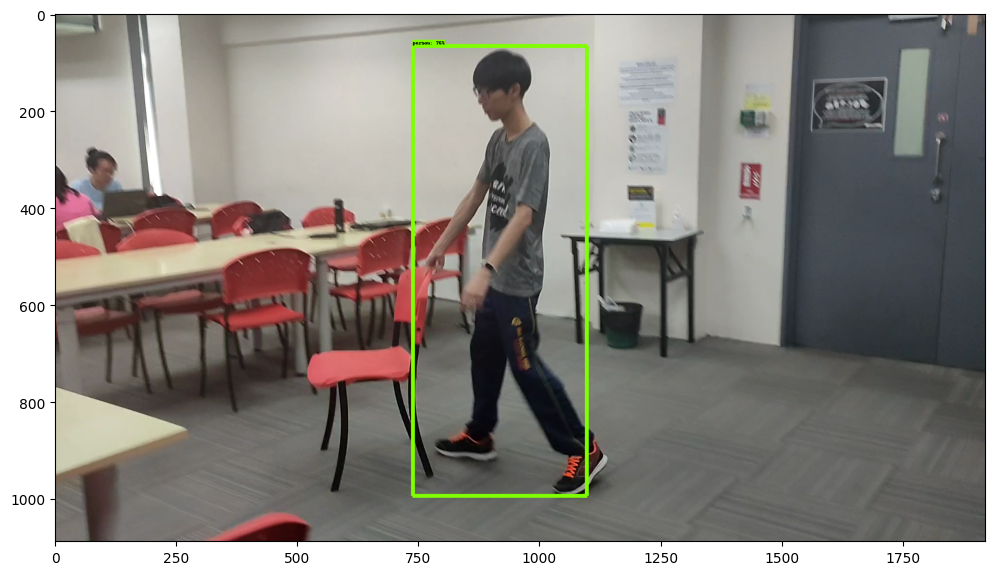

In [7]:
import numpy as np
from PIL import Image
import xml.etree.ElementTree as ET # for parsing XML
import cv2
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings
# This is required to display the images.
%matplotlib inline 

for image_path in IMAGE_PATHS:

    print('Running inference for {}... '.format(image_path), end='\n')

    # Puts image into numpy array to feed into tensorflow graph.
    # Note that by convention we put it into a numpy array with shape
    #   (height, width, channels), where channels=3 for RGB.
    image_np = np.array(Image.open(image_path))

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)

    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    # input_tensor = np.expand_dims(image_np, 0)
    detections = detect_fn(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                   for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    image_np_with_detections = image_np.copy()

    # Get the bounding box coordinates of objects with label id 1
    boxes = detections['detection_boxes'][detections['detection_classes'] == 1]
    classes =  detections['detection_classes'][detections['detection_classes'] == 1].astype(int)
    scores =  detections['detection_scores'][detections['detection_classes'] == 1]
    #print(boxes)
    #print(classes)
    #print(scores)

    # visualise the images
    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          boxes,
          classes,
          scores,
          category_index,
          use_normalized_coordinates=True,
          line_thickness=8,
          max_boxes_to_draw=20,
          min_score_thresh=scores[0]-0.0001, # select and show the highest score
          agnostic_mode=False)

    plt.figure(figsize = (12,8))
    plt.imshow(image_np_with_detections)

    # crop the images
    # Load image
    image_obj = cv2.imread(image_path)

    # Define bounding box coordinates
    ymin = boxes[0][0]
    xmin = boxes[0][1]
    ymax = boxes[0][2]
    xmax = boxes[0][3]
    coords = (xmin, ymin, xmax, ymax) # normalized bounding box coordinates
    directory_path, file_name = os.path.split(image_path) # get file name
    #saved_location = '/content/cropped/' + file_name # saved cropped image path
    # Get image height and width
    h, w = image_obj.shape[:2]

    # Calculate actual coordinates
    start_x, start_y = int(w * xmin), int(h * ymin)
    end_x, end_y = int(w * xmax), int(h * ymax)

    # Crop image
    cropped_img = image_obj[start_y:end_y, start_x:end_x]

    # Save cropped image according to its own class (sit, walk, fall) based on xml file
    path_annots = '/content/fall-detection/images_v2/test/'
    # make test folder for sit, walk and fall
    os.makedirs('/content/image_classification/test/sit', exist_ok=True)
    os.makedirs('/content/image_classification/test/walk', exist_ok=True)
    os.makedirs('/content/image_classification/test/fall', exist_ok=True)
    for filename in os.listdir(path_annots):
      if not filename.endswith('.xml'): continue
      fullname = os.path.join(path_annots, filename)
      tree = ET.parse(fullname)
      root = tree.getroot()
      full_image_name = tree.findtext("./filename")
      if full_image_name != file_name: continue
      classes = tree.findtext("./object/name")
      if classes == 'sit':
        saved_location = '/content/image_classification/test/sit/'+file_name
        cv2.imwrite(saved_location, cropped_img)
      elif classes == 'walk':
        saved_location = '/content/image_classification/test/walk/'+file_name
        cv2.imwrite(saved_location, cropped_img)
      elif classes == 'fall':
        saved_location = '/content/image_classification/test/fall/'+file_name
        cv2.imwrite(saved_location, cropped_img)

    print('Done')
plt.show()

----
# 2. Fall Recognition Model

## Crop Training Set Based on Bounding Box

In [8]:
import numpy as np # linear algebra
import xml.etree.ElementTree as ET # for parsing XML
from PIL import Image # to read images
import os
import glob
path_annots = '/content/fall-detection/images_v2/train/'
path_images = '/content/fall-detection/images_v2/train/'
# make foler for sit, walk and fall
os.makedirs('/content/image_classification/train/sit', exist_ok=True)
os.makedirs('/content/image_classification/train/walk', exist_ok=True)
os.makedirs('/content/image_classification/train/fall', exist_ok=True)
#automated code
for filename in os.listdir(path_annots):
    if not filename.endswith('.xml'): continue
    fullname = os.path.join(path_annots, filename)
    tree = ET.parse(fullname)
    root = tree.getroot()
    # height = int(tree.findtext("./size/height"))
    # width = int(tree.findtext("./size/width"))
    xmin = int(tree.findtext("./object/bndbox/xmin"))
    ymin = int(tree.findtext("./object/bndbox/ymin"))
    xmax = int(tree.findtext("./object/bndbox/xmax"))
    ymax = int(tree.findtext("./object/bndbox/ymax"))
    full_image_name = tree.findtext("./filename")
    #print(full_image_name)
    classes = tree.findtext("./object/name")
    #print(classes)
    im = Image.open(path_images + full_image_name)
    im1 = im.crop((xmin, ymin, xmax, ymax))
    if classes == 'sit':
      im1.save("/content/image_classification/train/sit/"+full_image_name)
    elif classes == 'walk':
      im1.save("/content/image_classification/train/walk/"+full_image_name)
    elif classes == 'fall':
      im1.save("/content/image_classification/train/fall/"+full_image_name)
print('Done cropping')

Done cropping


## Data Preprocessing

Create a `tf.data.Dataset` for training and validation using the `tf.keras.utils.image_dataset_from_directory` utility.

In [93]:
# training and test set directory
train_dir = '/content/image_classification/train'
validation_dir = '/content/image_classification/test'

BATCH_SIZE = 32
IMG_SIZE = (160, 160)

In [94]:
train_dataset = tf.keras.utils.image_dataset_from_directory(train_dir,
                                                            shuffle=True,
                                                            batch_size=BATCH_SIZE,
                                                            image_size=IMG_SIZE)

Found 575 files belonging to 3 classes.


In [95]:
validation_dataset = tf.keras.utils.image_dataset_from_directory(validation_dir,
                                                          shuffle=True,
                                                          batch_size=BATCH_SIZE,
                                                          image_size=IMG_SIZE)

Found 60 files belonging to 3 classes.


Show the first nine images and labels from the training set:

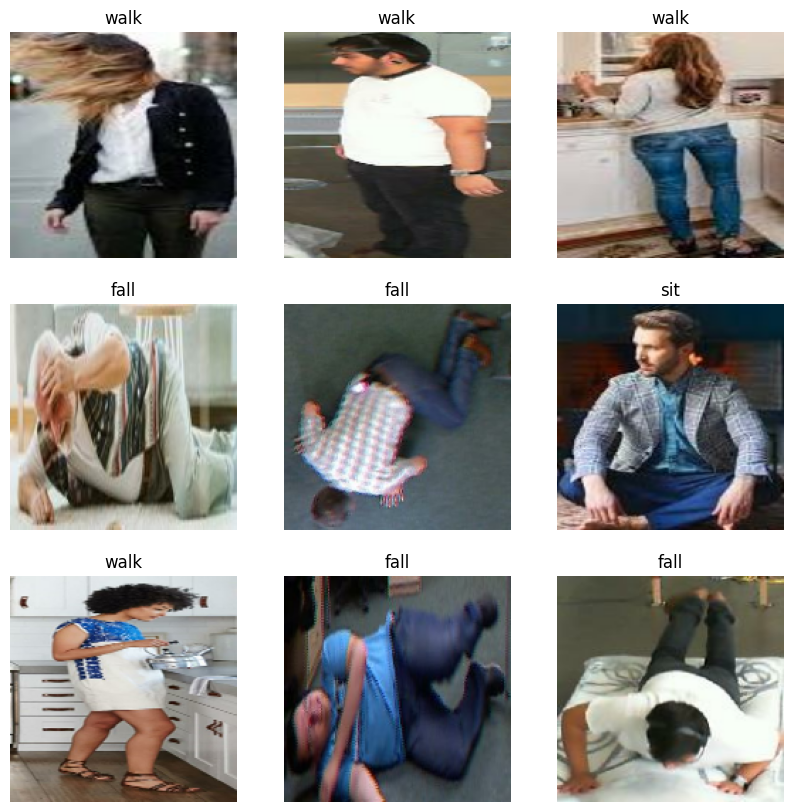

In [96]:
class_names = train_dataset.class_names

plt.figure(figsize=(10, 10))
for images, labels in train_dataset.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

## Data Augmentation

When don't have a large image dataset, it's a good practice to artificially introduce sample diversity by applying random, yet realistic, transformations to the training images, such as rotation and horizontal flipping. This helps expose the model to different aspects of the training data and reduce overfitting.

In [15]:
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.RandomFlip('horizontal'),
  tf.keras.layers.RandomRotation(0.2),
])

Apply these layers to the same image and see the result.

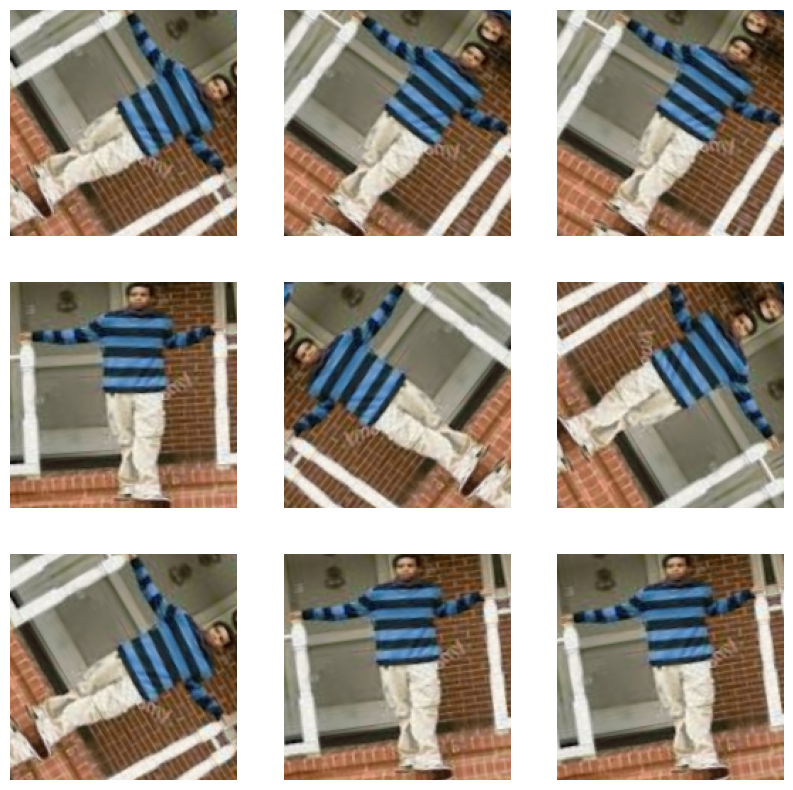

In [16]:
for image, _ in train_dataset.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

## Rescale Pixel Values

 `tf.keras.applications.MobileNetV2` MobileNetV2 will use as the base model. This model expects pixel values in `[-1, 1]`, but at this point, the pixel values in the images are in `[0, 255]`. To rescale them, the preprocessing method included with the model is used.

In [17]:
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

## Create the Base Model from the Pre-Trained Convnets

In [18]:
# Create the base model from the pre-trained model MobileNet V2
IMG_SHAPE = (160, 160, 3)
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

9406464/9406464 [==============================] - 0s 0us/step


This feature extractor converts each `160x160x3` image into a `5x5x1280` block of features.

In [19]:
image_batch, label_batch = next(iter(train_dataset))
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(8, 5, 5, 1280)


## Feature Extraction

### Freeze the convolutional base

Freezing (by setting layer.trainable = False) prevents the weights in a given layer from being updated during training. MobileNet V2 has many layers, so setting the entire model's trainable flag to False will freeze all of them.

In [20]:
base_model.trainable = False

### Summary of base model

In [21]:
# Let's take a look at the base model architecture
base_model.summary()

Model: "mobilenetv2_1.00_160"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 80, 80, 32)   864         ['input_1[0][0]']                
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 80, 80, 32)   128         ['Conv1[0][0]']                  
                                                                                                  
 Conv1_relu (ReLU)              (None, 80, 80, 32)   0           ['bn_Conv1[0][

### Add a classification head

To generate predictions from the block of features, average over the spatial `5x5` spatial locations, using a `tf.keras.layers.GlobalAveragePooling2D` layer to convert the features to  a single 1280-element vector per image.

In [22]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(8, 1280)


Apply a `tf.keras.layers.Dense` layer which is the output layer. It has 3 neurons because the dataset has three predefined classes. `softmax` is set as the activation function because the dataset has three pre-defined classes. The `softmax` activation function is used for multi-label classification.

In [23]:
prediction_layer = tf.keras.layers.Dense(3,activation='softmax')
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(8, 3)


Build a model by chaining together the data augmentation, rescaling, `base_model` and feature extractor layers. `training=False` is used as the model contains a `BatchNormalization` layer.

In [24]:
inputs = tf.keras.Input(shape=(160, 160, 3))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.3)(x)
outputs = prediction_layer(x)
model = tf.keras.Model(inputs, outputs)

### Compile the model

Compile the model before training it. Since there are three classes, use the `tf.keras.losses.SparseCategoricalCrossentropy` loss

In [25]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

Summary of final model

In [26]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 160, 160, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 160, 160, 3)       0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 160, 160, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 160, 160, 3)      0         
 a)                                                              
                                                                 
 mobilenetv2_1.00_160 (Funct  (None, 5, 5, 1280)       2257984   
 ional)                                                          
                                                             

The 2.2 million parameters in MobileNet are frozen, but there are 3.8 thousand _trainable_ parameters in the Dense layer. These are divided between two `tf.Variable` objects, the weights and biases.

In [27]:
len(model.trainable_variables)

2

### Train the model

In [28]:
initial_epochs = 30

loss0, accuracy0 = model.evaluate(validation_dataset)

6/6 [==============================] - 3s 76ms/step - loss: 1.2281 - accuracy: 0.2727


In [29]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 1.23
initial accuracy: 0.27


In [30]:
history = model.fit(train_dataset,
                    epochs=initial_epochs,
                    validation_data=validation_dataset)

Epoch 1/30
72/72 [==============================] - 6s 33ms/step - loss: 1.4436 - accuracy: 0.4400 - val_loss: 1.1793 - val_accuracy: 0.3409
Epoch 2/30
72/72 [==============================] - 2s 30ms/step - loss: 1.3058 - accuracy: 0.4487 - val_loss: 1.1040 - val_accuracy: 0.3864
Epoch 3/30
72/72 [==============================] - 4s 49ms/step - loss: 1.1834 - accuracy: 0.4957 - val_loss: 0.9927 - val_accuracy: 0.4318
Epoch 4/30
72/72 [==============================] - 4s 48ms/step - loss: 1.1432 - accuracy: 0.5043 - val_loss: 0.9978 - val_accuracy: 0.4545
Epoch 5/30
72/72 [==============================] - 3s 32ms/step - loss: 1.0260 - accuracy: 0.5600 - val_loss: 0.9412 - val_accuracy: 0.5227
Epoch 6/30
72/72 [==============================] - 2s 29ms/step - loss: 1.0197 - accuracy: 0.5530 - val_loss: 0.9750 - val_accuracy: 0.5000
Epoch 7/30
72/72 [==============================] - 2s 28ms/step - loss: 0.9212 - accuracy: 0.6035 - val_loss: 0.8212 - val_accuracy: 0.5455
Epoch 8/30
72

## Learning Curve

Let's take a look at the learning curves of the training and validation accuracy/loss when using the MobileNetV2 base model as a fixed feature extractor.

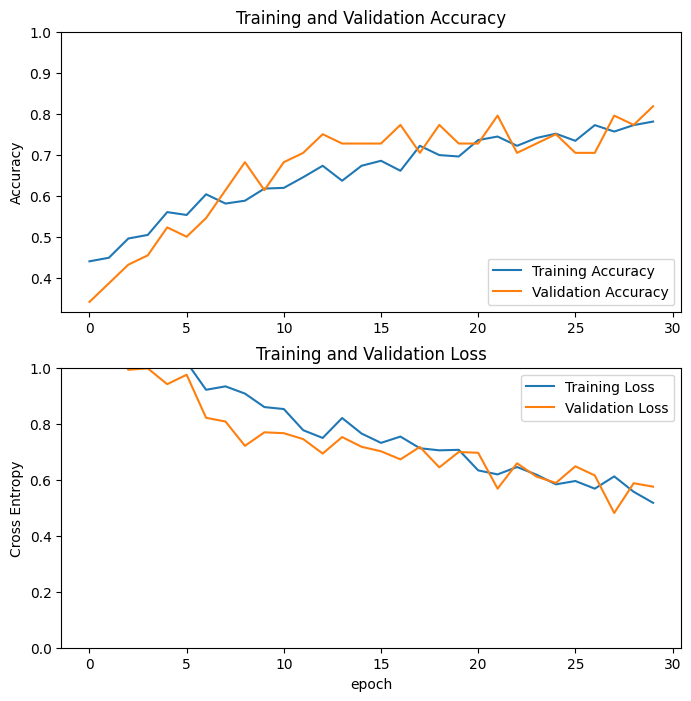

In [31]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

## Fine Tuning

### Un-freeze the top layers of the model

Unfreeze the `base_model` and set the bottom layers to be un-trainable. Then, the model is recompiled (necessary for these changes to take effect), and resume training.

In [32]:
base_model.trainable = True

In [33]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable = False

Number of layers in the base model:  154


### Compile the model

As want to readapt the pretrained weights, it is important to use a lower learning rate at this stage. Otherwise, the model could overfit very quickly.

In [34]:
model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.RMSprop(learning_rate=base_learning_rate/10),
              metrics=['accuracy'])

Summary of Model

In [35]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 160, 160, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 160, 160, 3)       0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 160, 160, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 160, 160, 3)      0         
 a)                                                              
                                                                 
 mobilenetv2_1.00_160 (Funct  (None, 5, 5, 1280)       2257984   
 ional)                                                          
                                                             

In [36]:
len(model.trainable_variables)

56

### Continue training the model

In [37]:
fine_tune_epochs = 30
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_dataset,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_dataset)

Epoch 30/60
72/72 [==============================] - 17s 46ms/step - loss: 0.5644 - accuracy: 0.7826 - val_loss: 0.6467 - val_accuracy: 0.6591
Epoch 31/60
72/72 [==============================] - 2s 30ms/step - loss: 0.5334 - accuracy: 0.7739 - val_loss: 0.8458 - val_accuracy: 0.6364
Epoch 32/60
72/72 [==============================] - 2s 31ms/step - loss: 0.5099 - accuracy: 0.7913 - val_loss: 0.5331 - val_accuracy: 0.7500
Epoch 33/60
72/72 [==============================] - 4s 50ms/step - loss: 0.4460 - accuracy: 0.8017 - val_loss: 0.6765 - val_accuracy: 0.6591
Epoch 34/60
72/72 [==============================] - 4s 55ms/step - loss: 0.4294 - accuracy: 0.8243 - val_loss: 0.5010 - val_accuracy: 0.7727
Epoch 35/60
72/72 [==============================] - 3s 35ms/step - loss: 0.3586 - accuracy: 0.8609 - val_loss: 0.4945 - val_accuracy: 0.7500
Epoch 36/60
72/72 [==============================] - 3s 33ms/step - loss: 0.3373 - accuracy: 0.8539 - val_loss: 0.4469 - val_accuracy: 0.7500
Epoch

In [38]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

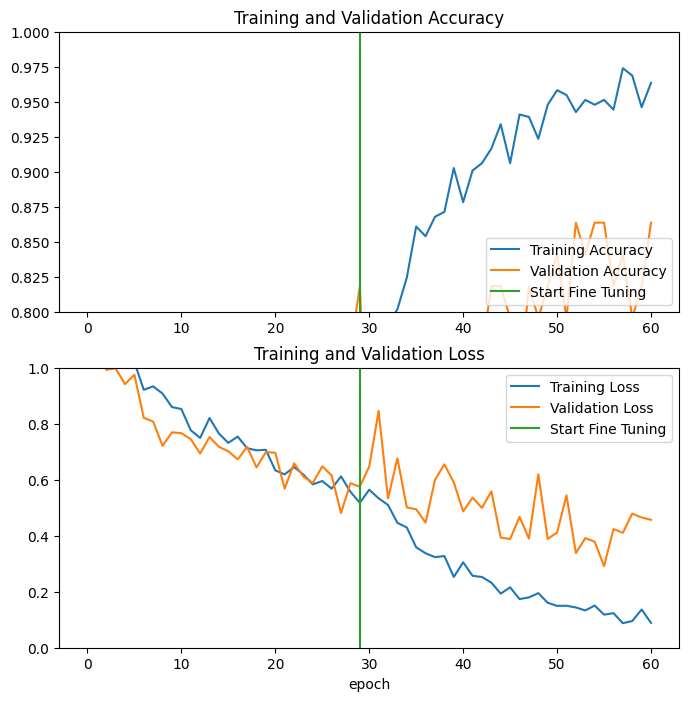

In [39]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

## Evaluation and prediction

In [40]:
loss, accuracy = model.evaluate(test_dataset)
print('Test accuracy :', accuracy)

2/2 [==============================] - 0s 18ms/step - loss: 0.5666 - accuracy: 0.8750
Test accuracy : 0.875


Actual Labels: fall(0) sit(1) walk(2)
 [1 0 2 2 0 1 1 2 0 1 1 2 1 0 0 1 1 1 0 0 2 2 0 2 1 0 1 1 2 2 0 0]

Predicted Labels:



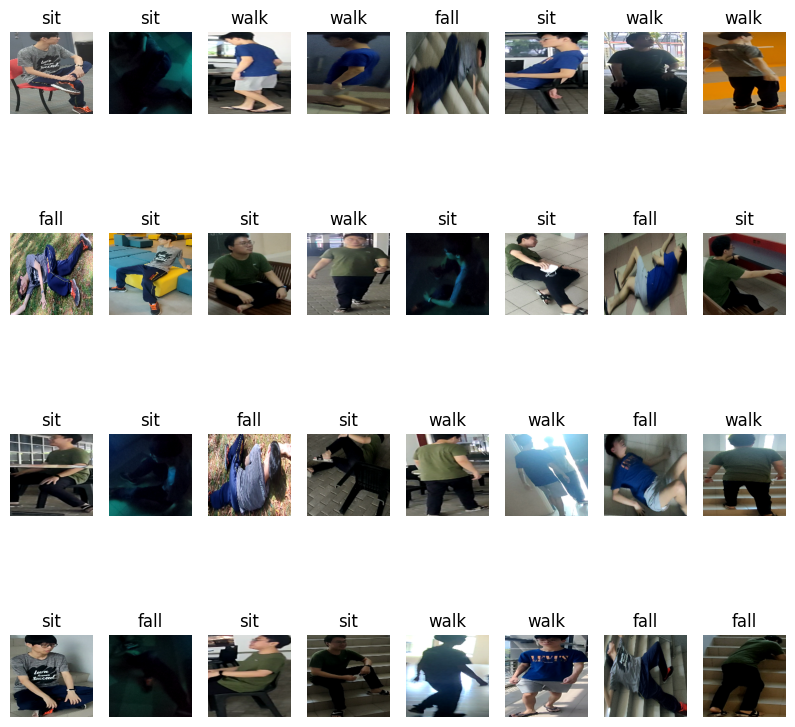

In [101]:
# Retrieve a batch of images from the test set
image_batch, label_batch = validation_dataset.as_numpy_iterator().next()
predictions = model.predict_on_batch(image_batch)

print('Actual Labels: fall(0) sit(1) walk(2)\n', label_batch)
print('\nPredicted Labels:\n')
plt.figure(figsize=(10, 10))
for i in range(32):
  score = np.argmax(predictions[i])
  ax = plt.subplot(4, 8, i + 1)
  plt.imshow(image_batch[i].astype("uint8"))
  plt.title(class_names[score])
  plt.axis("off")

In [102]:
y_pred = np.argmax(predictions, axis=1)
y_true = label_batch

In [103]:
print(class_names)

['fall', 'sit', 'walk']


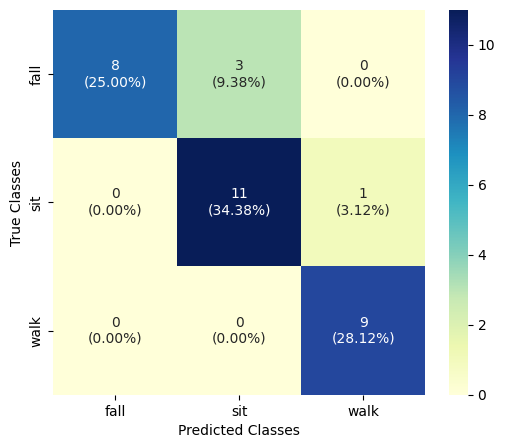

In [106]:
cf_mtx = confusion_matrix(y_true, y_pred)

group_counts = ["{0:0.0f}".format(value) for value in cf_mtx.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_mtx.flatten()/np.sum(cf_mtx)]
box_labels = [f"{v1}\n({v2})" for v1, v2 in zip(group_counts, group_percentages)]
box_labels = np.asarray(box_labels).reshape(3, 3)

plt.figure(figsize = (6, 5))
sns.heatmap(cf_mtx, xticklabels=class_names, yticklabels=class_names,
           cmap="YlGnBu", fmt="", annot=box_labels)
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

In [105]:
print(classification_report(y_true, y_pred, target_names=class_names))

              precision    recall  f1-score   support

        fall       1.00      0.73      0.84        11
         sit       0.79      0.92      0.85        12
        walk       0.90      1.00      0.95         9

    accuracy                           0.88        32
   macro avg       0.90      0.88      0.88        32
weighted avg       0.89      0.88      0.87        32

